# Transfer learning to predict if an image is a mint or basil leave

In [1]:
import tensorflow.keras
from tensorflow.keras.preprocessing import image
import matplotlib.pyplot as plt
from PIL import Image
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.applications.vgg16 import preprocess_input
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.applications.vgg16 import decode_predictions
import numpy as np
import os
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Flatten
from tensorflow.keras.utils import to_categorical
from tensorflow.keras import backend as K
import cv2

K.clear_session()

## 1) Load the pretrained network


In [2]:
model = VGG16(weights='imagenet')
# Look at the model
model.summary()

Model: "vgg16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0     

## 2) Load the data

IMG_4176.JPG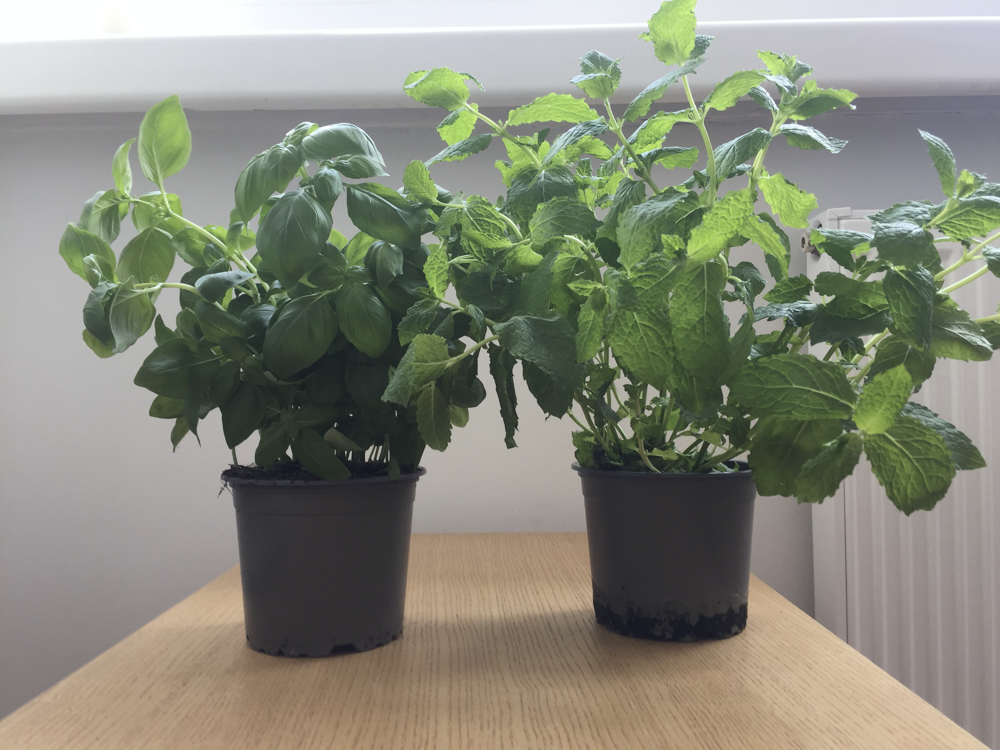

Screenshot 2020-10-09 at 14.21.03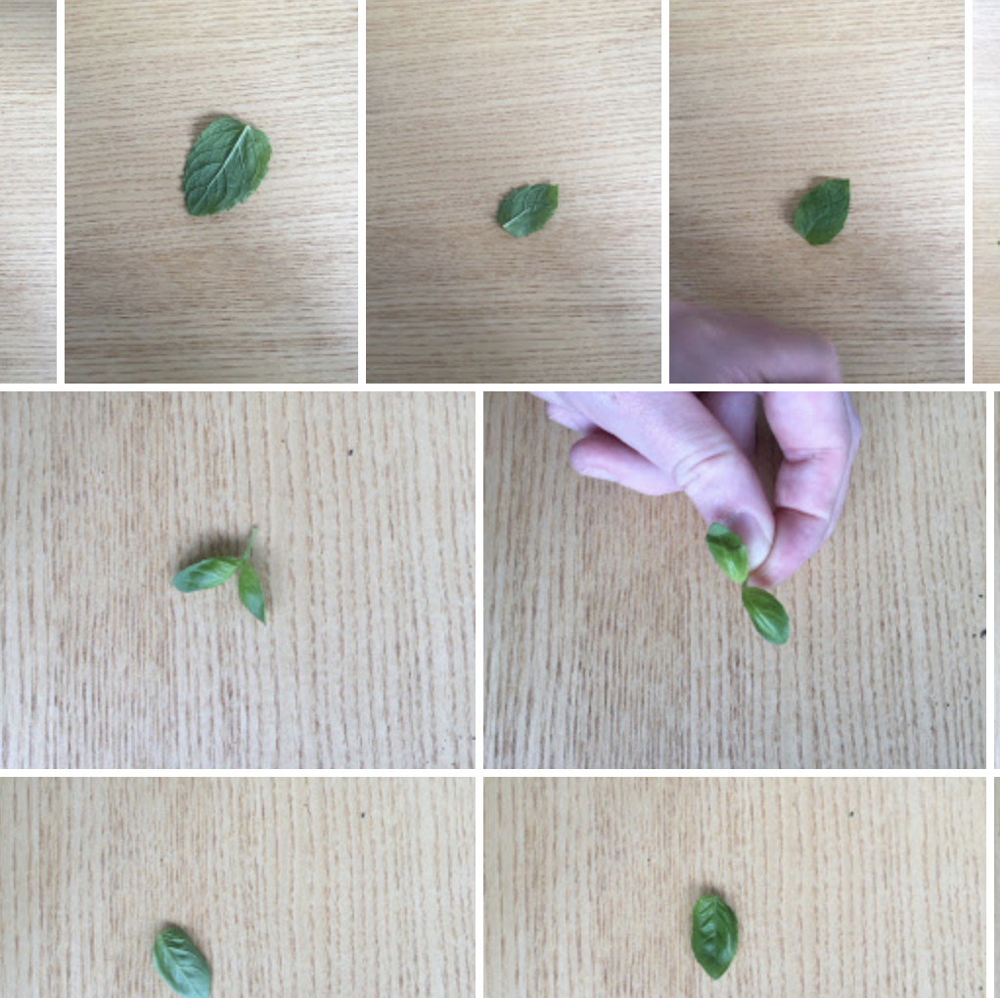


In [3]:
def read_images(path):
    """Returns a list of input images from the given path in the right size"""
    images = []
    for fn in os.listdir(path):
        im = image.load_img(path + '/' + fn, target_size=(224, 224))
        im = image.img_to_array(im)
        X = im.reshape(224, 224, 3)
        images.append(X)
        
    X = np.array(images)
    X = preprocess_input(X)
    return X

In [6]:
basil = read_images('./data_pictures_basil_mint/Basil/')

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


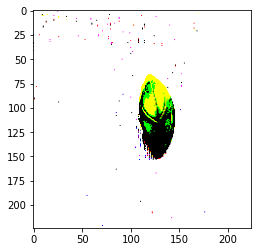

In [7]:
plt.imshow(basil[1])

In [8]:
mint = read_images('./data_pictures_basil_mint/Mint/')

##  Use the network for my own purposes

In [9]:
# Do not include "the top"
cropped_model = VGG16(input_shape=(224, 224, 3), weights='imagenet', include_top=False)

In [10]:
# freeze the layers
for layer in cropped_model.layers:
    layer.trainable = False
# Look at the summary
cropped_model.summary()

Model: "vgg16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0     

### Create a vector with labels

In [11]:
basil.shape, mint.shape

((119, 224, 224, 3), (90, 224, 224, 3))

In [12]:
# Let's create an array with 1 for basil and 0 for mint 
y = np.append(np.ones(119), np.zeros(90))
y

array([1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0.])

### prepare the data

In [13]:
# Stack the input images
X = np.vstack([basil, mint])
X.shape

(209, 224, 224, 3)

In [14]:
# Zip X and y together
data = np.array(list(zip(X, y)))

<ipython-input-14-029a48f36369>:2: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  data = np.array(list(zip(X, y)))


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


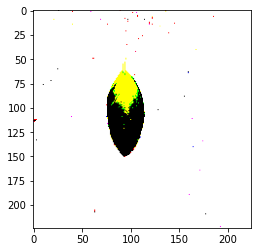

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


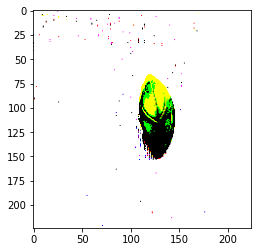

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


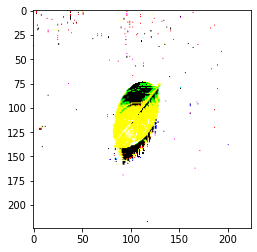

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


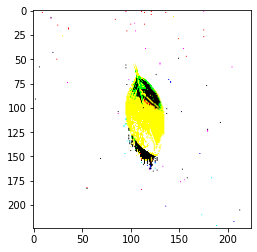

I am a basil leaf


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


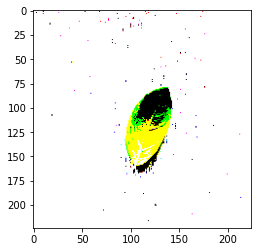

I am a basil leaf


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


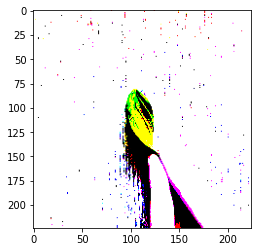

I am a basil leaf


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


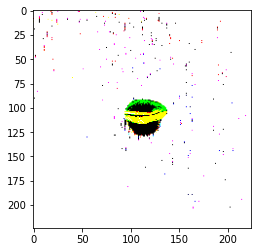

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


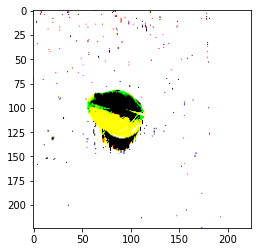

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


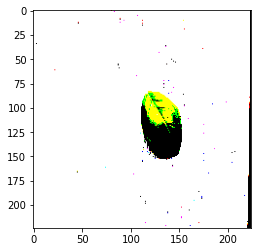

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


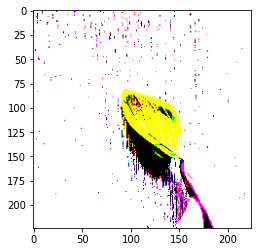

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


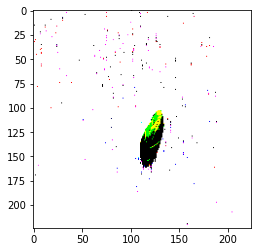

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


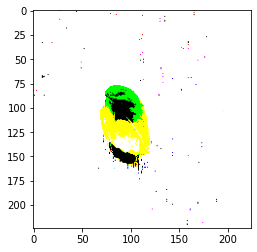

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


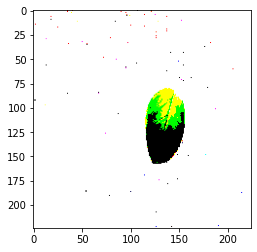

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


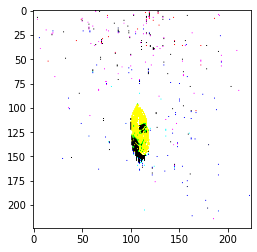

I am a basil leaf


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


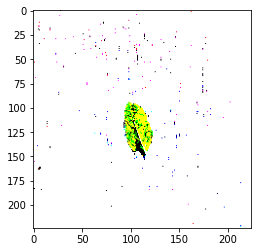

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


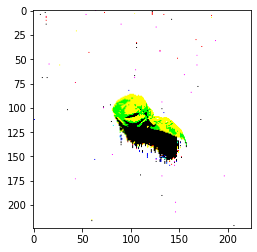

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


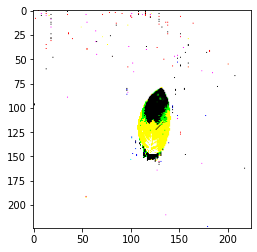

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


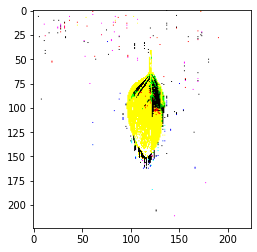

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


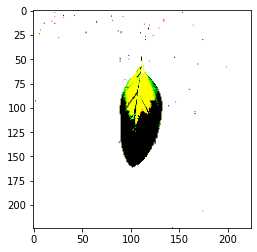

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


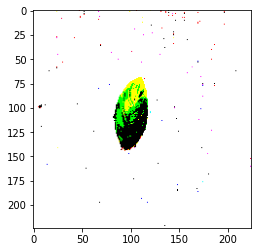

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


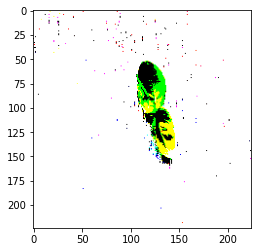

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


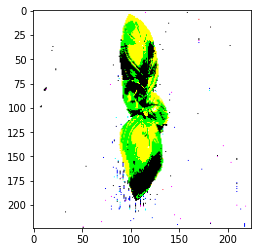

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


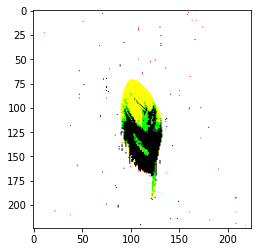

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


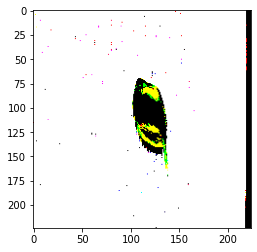

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


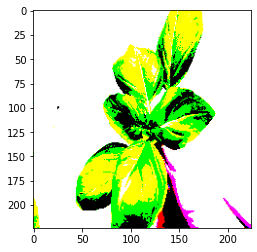

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


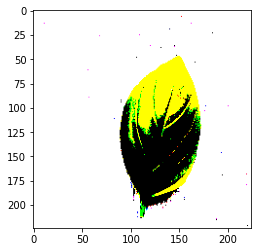

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


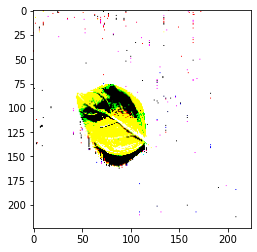

I am a basil leaf


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


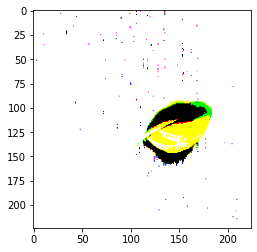

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


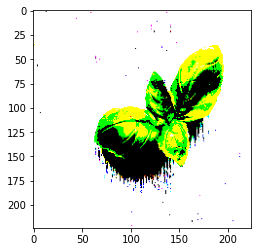

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


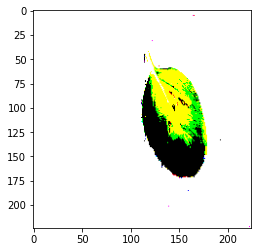

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


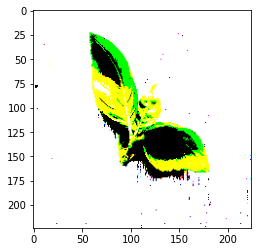

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


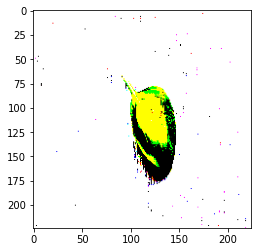

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


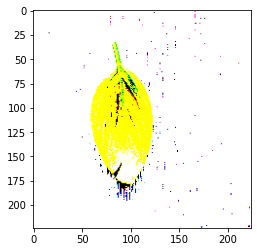

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


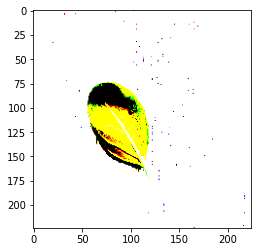

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


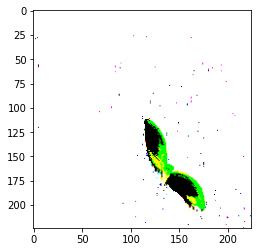

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


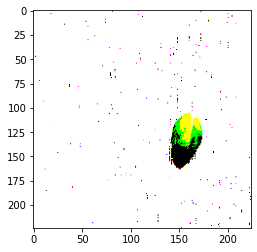

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


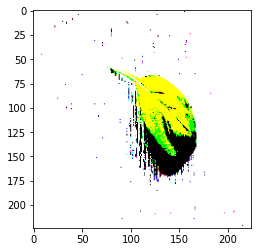

I am a basil leaf


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


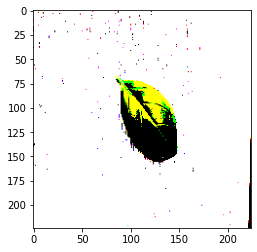

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


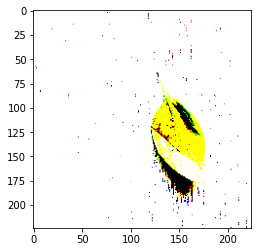

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


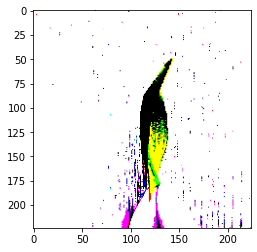

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


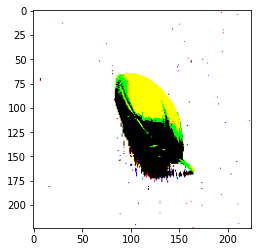

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


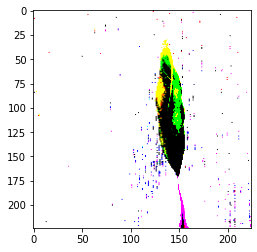

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


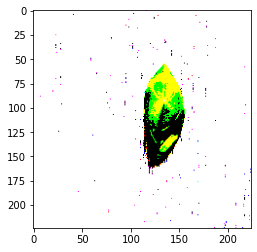

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


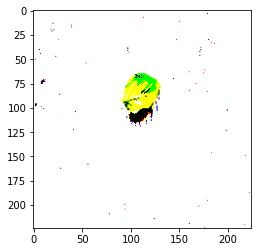

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


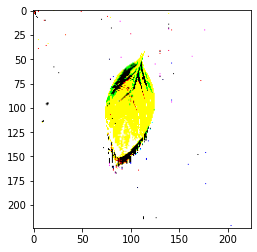

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


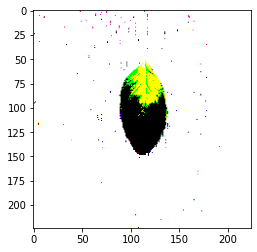

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


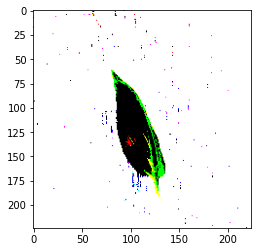

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


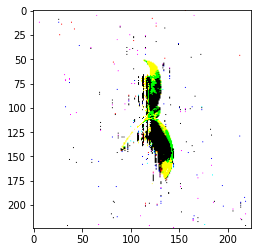

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


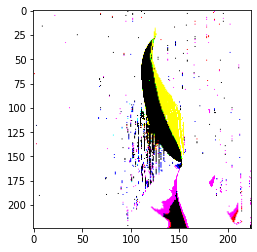

I am a basil leaf


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


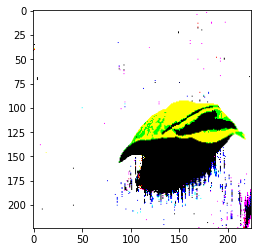

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


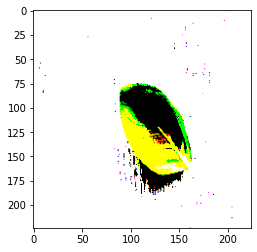

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


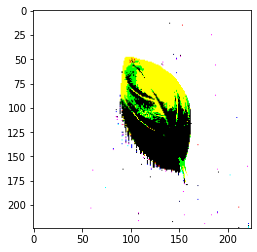

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


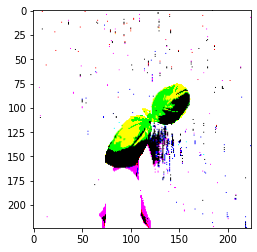

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


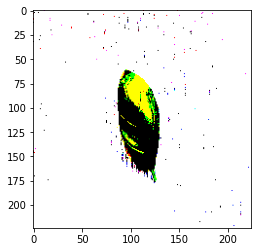

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


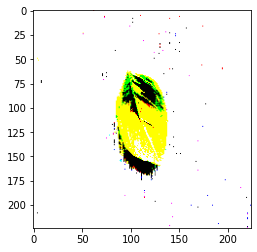

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


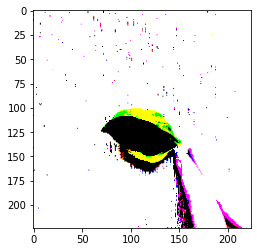

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


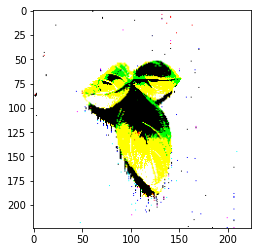

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


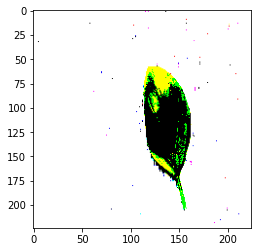

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


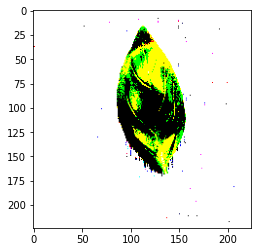

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


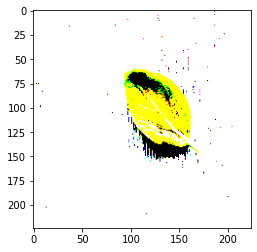

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


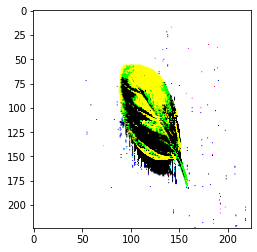

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


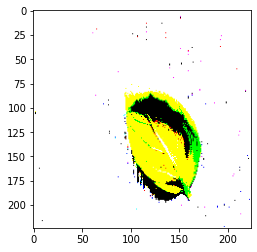

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


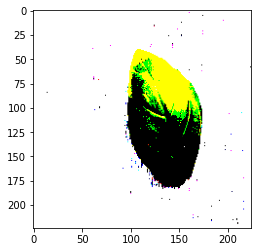

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


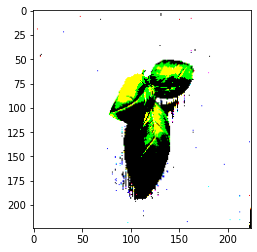

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


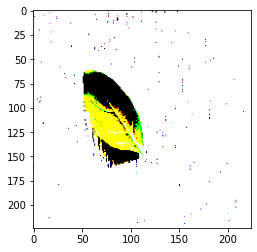

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


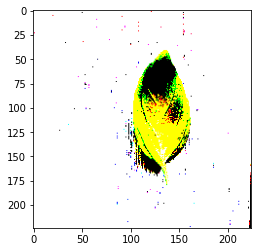

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


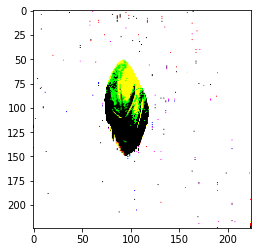

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


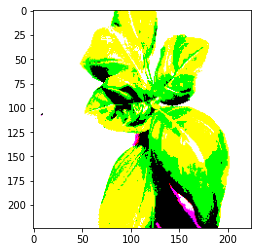

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


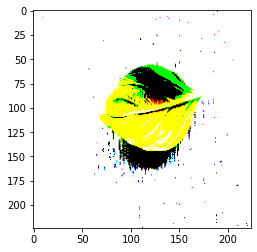

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


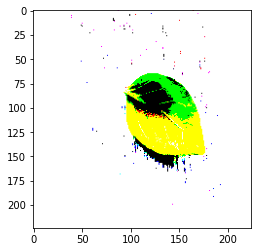

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


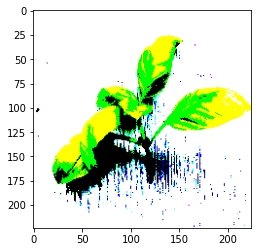

I am a basil leaf


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


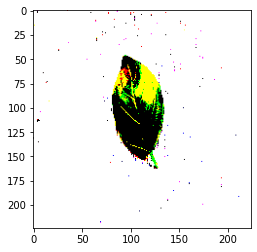

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


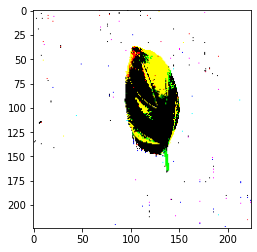

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


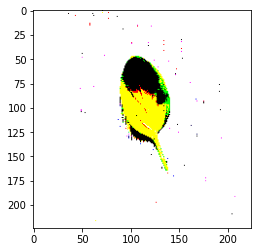

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


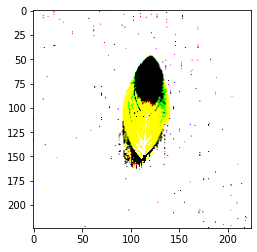

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


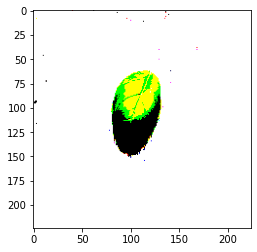

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


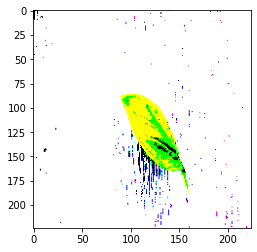

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


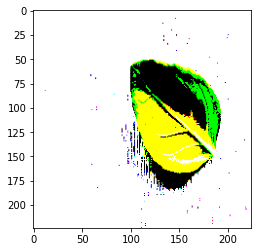

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


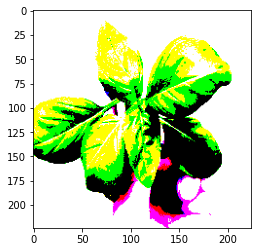

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


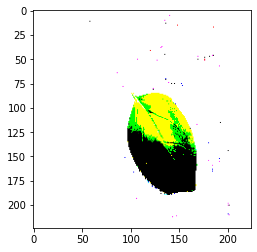

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


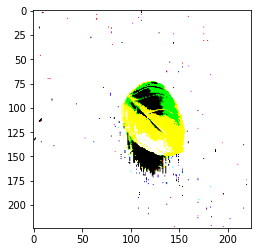

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


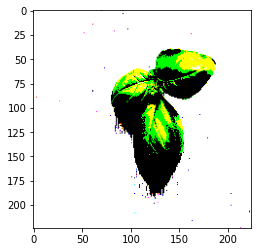

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


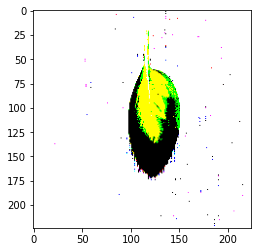

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


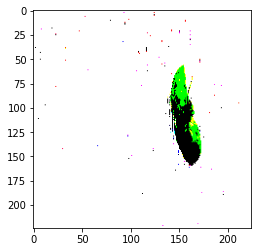

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


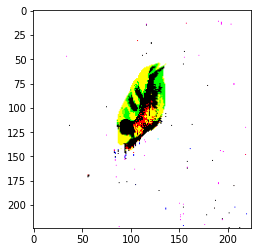

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


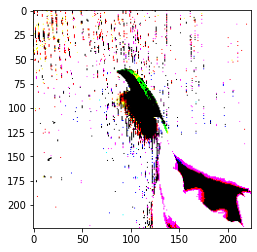

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


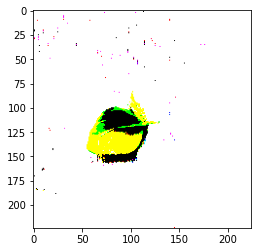

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


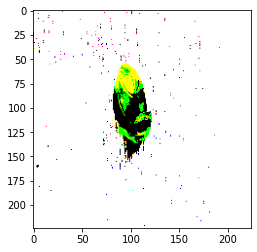

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


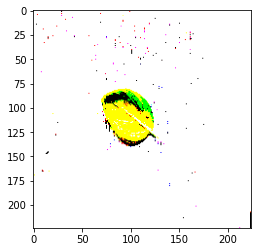

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


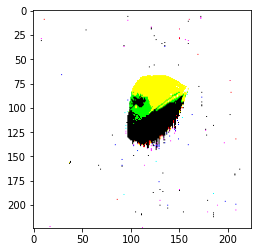

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


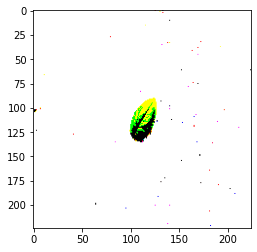

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


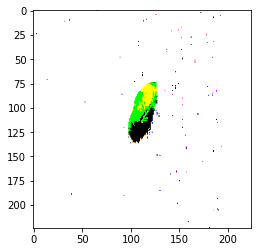

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


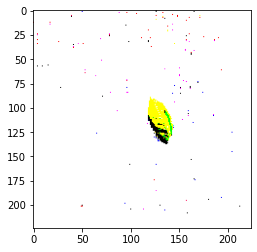

I am a basil leaf


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


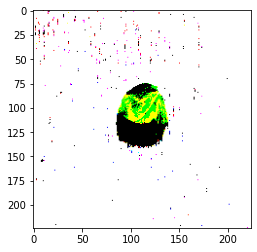

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


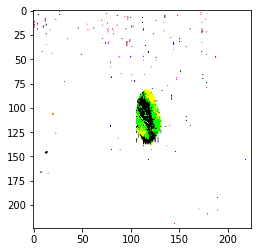

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


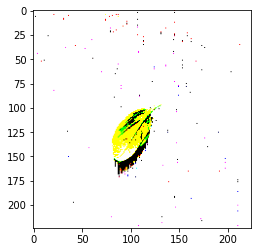

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


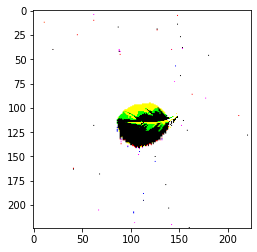

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


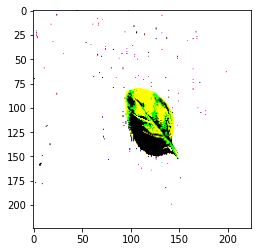

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


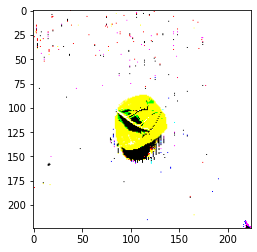

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


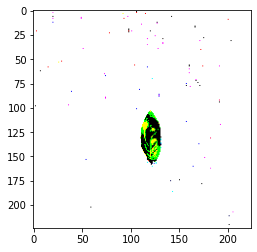

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


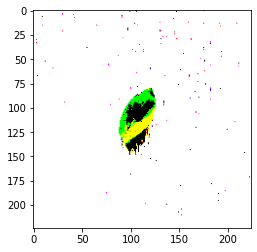

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


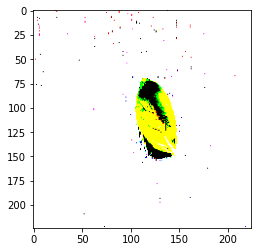

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


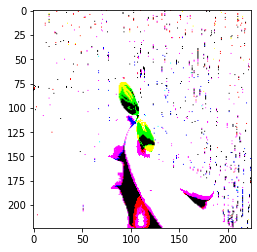

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


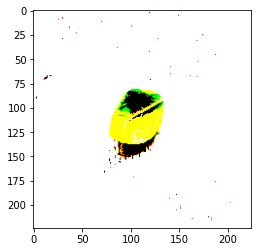

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


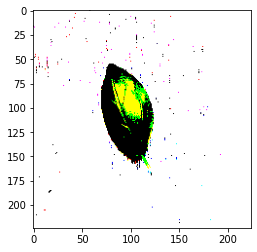

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


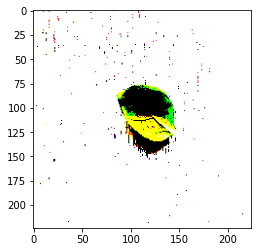

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


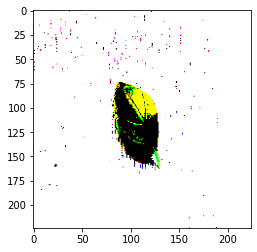

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


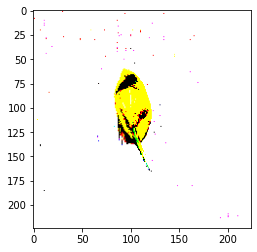

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


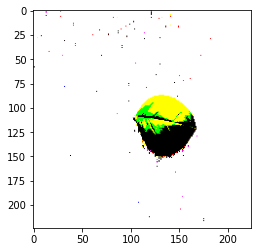

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


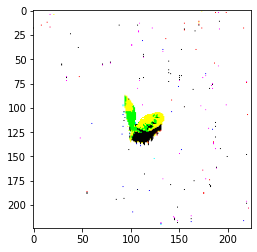

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


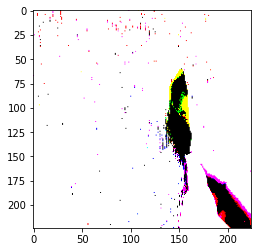

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


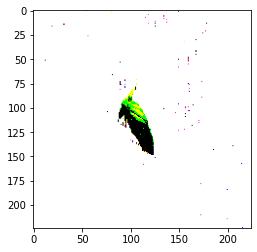

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


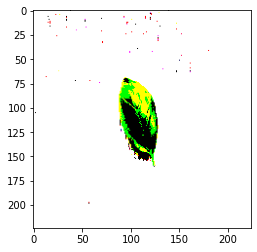

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


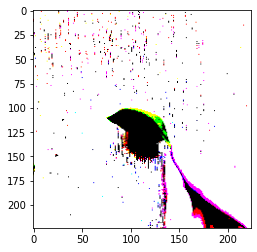

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


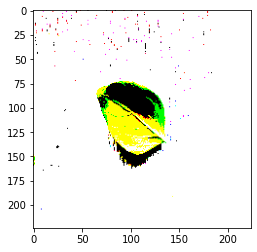

I am a basil leaf


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


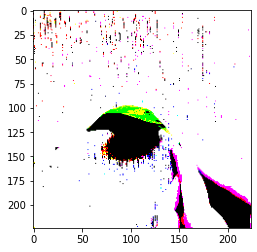

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


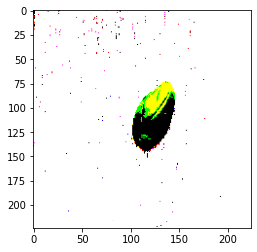

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


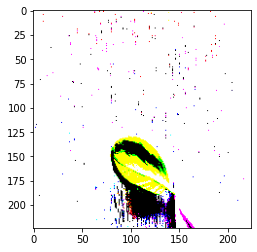

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a basil leaf


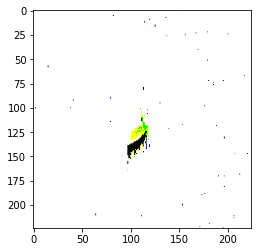

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


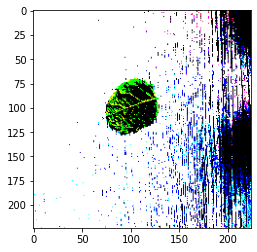

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


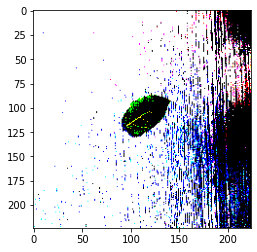

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


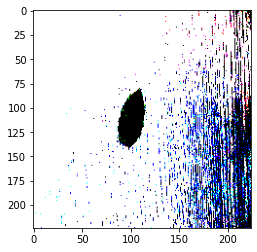

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


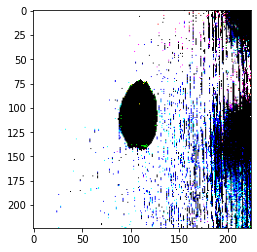

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


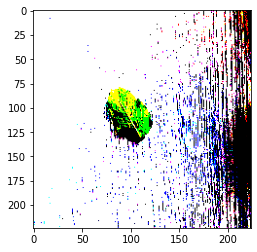

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


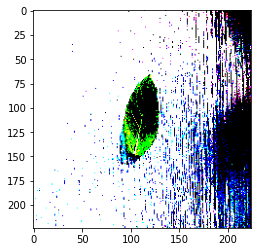

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


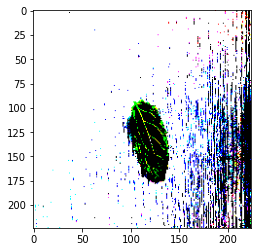

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


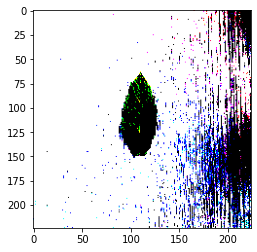

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


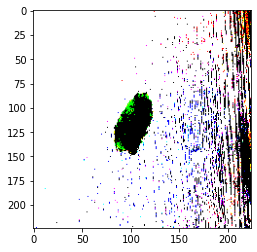

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


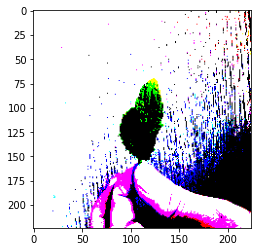

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


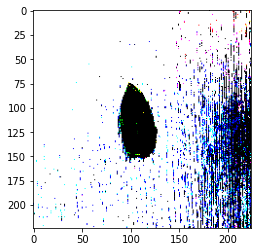

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


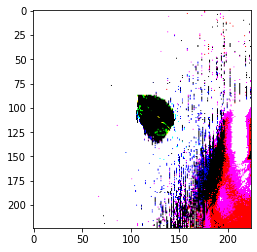

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


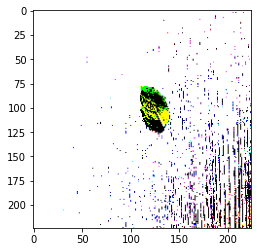

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


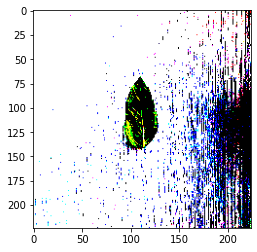

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


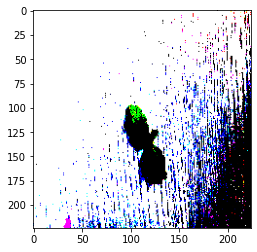

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


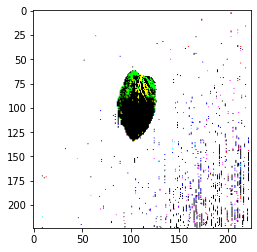

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


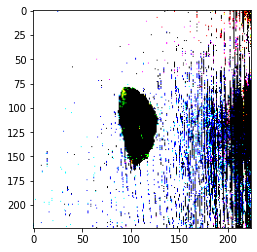

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


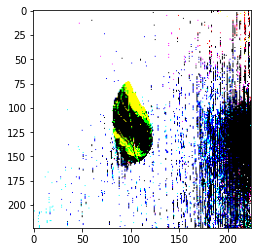

I am a mint leaf


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


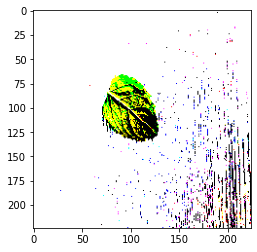

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


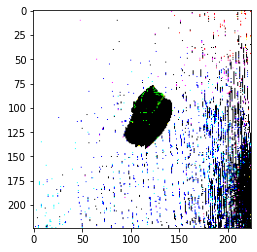

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


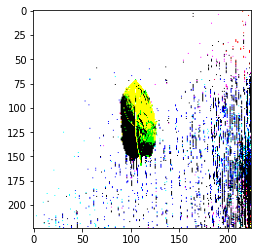

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


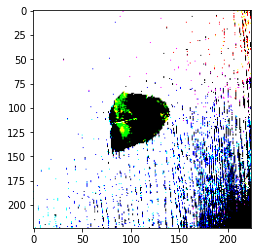

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


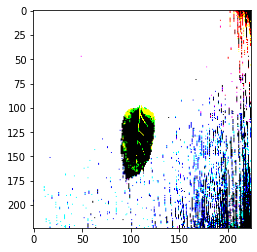

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


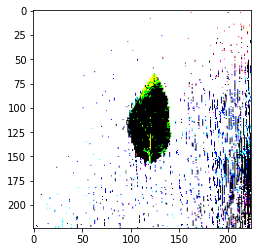

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


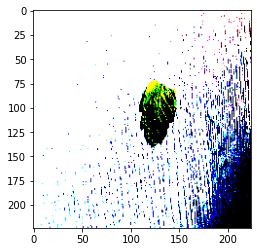

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


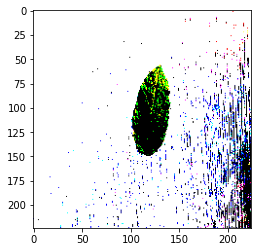

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


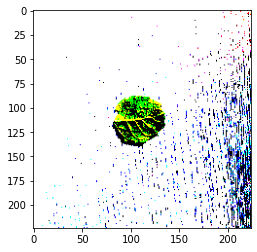

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


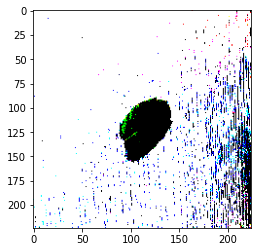

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


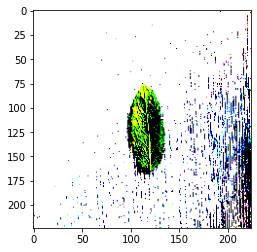

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


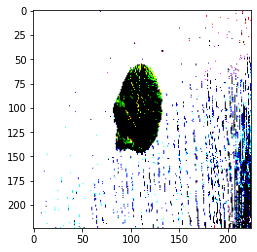

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


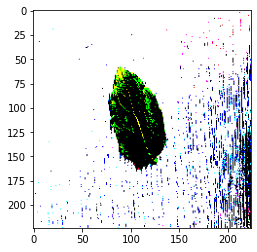

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


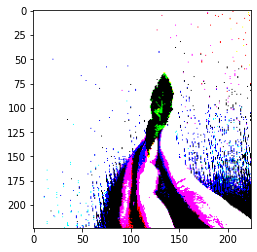

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


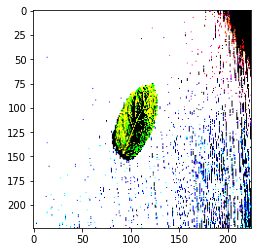

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


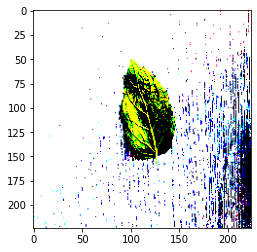

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


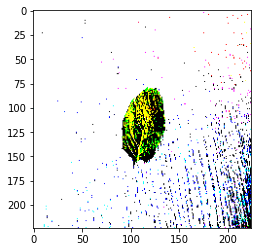

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


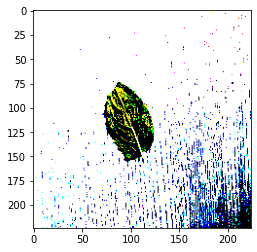

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


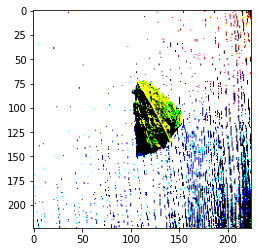

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


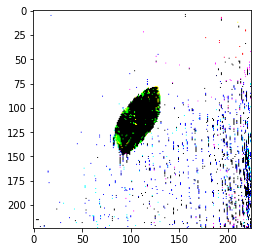

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


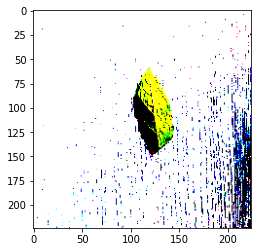

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


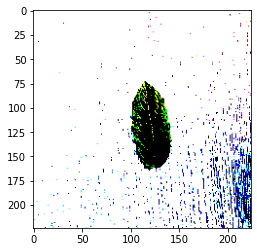

I am a mint leaf


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


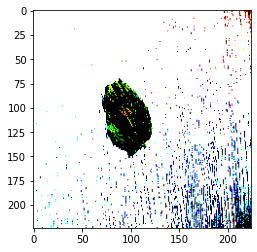

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


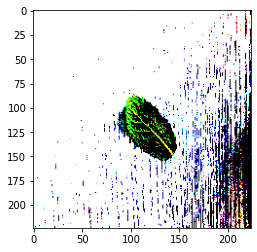

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


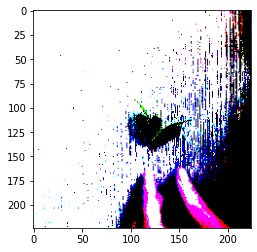

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


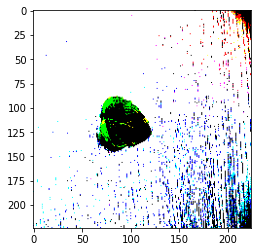

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


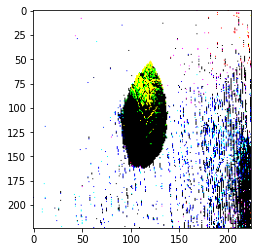

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


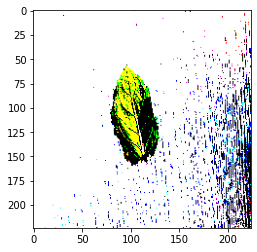

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


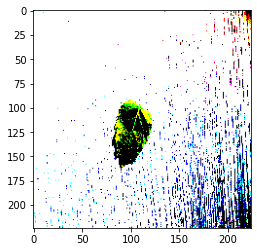

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


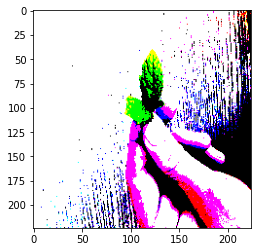

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


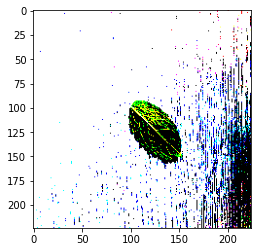

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


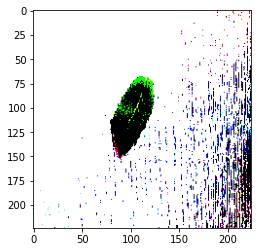

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


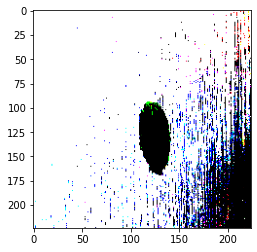

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


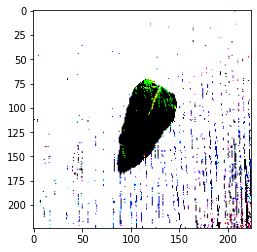

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


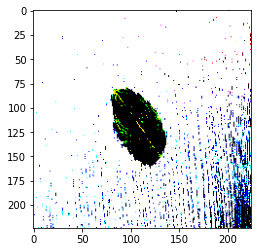

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


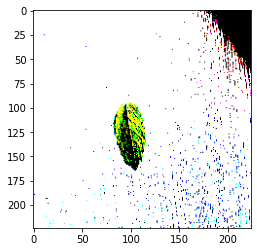

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


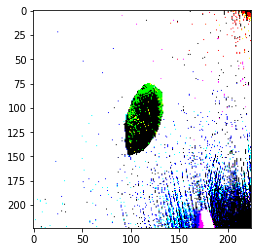

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


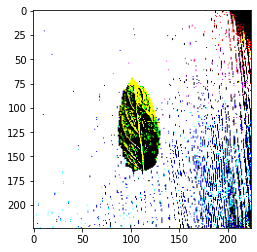

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


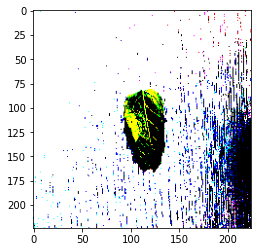

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


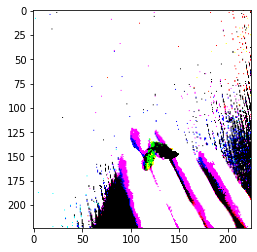

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


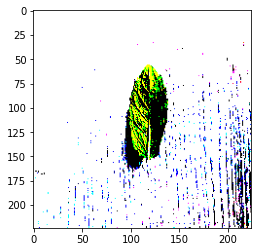

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


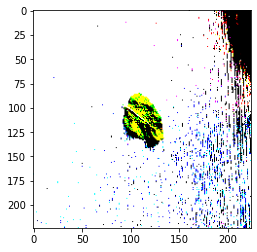

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


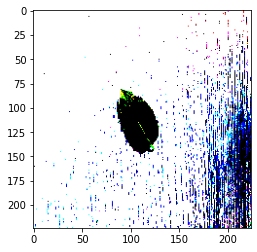

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


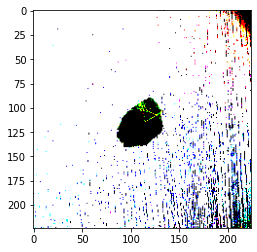

I am a mint leaf


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


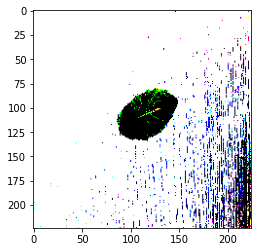

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


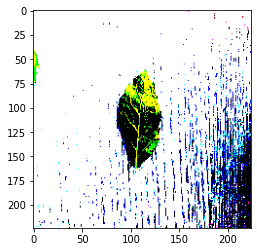

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


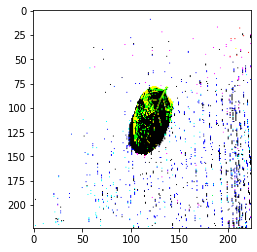

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


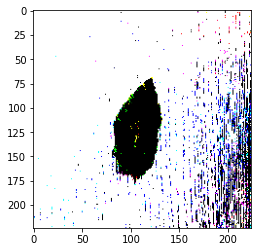

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


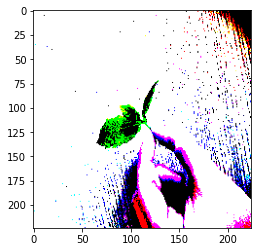

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


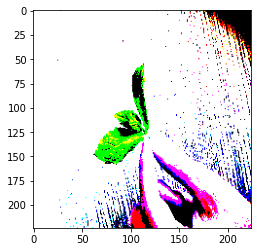

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


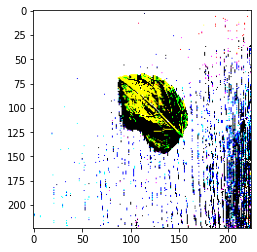

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


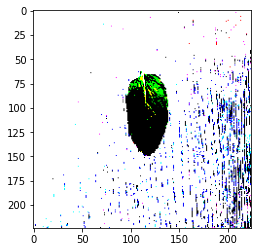

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


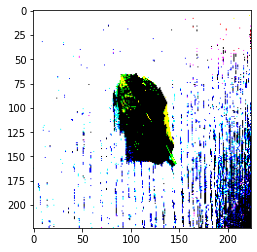

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


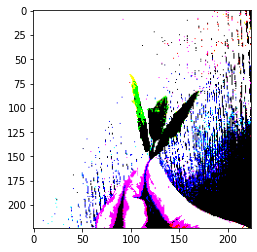

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


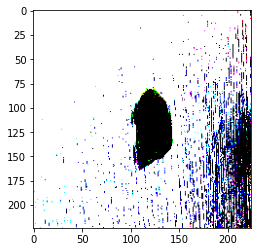

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


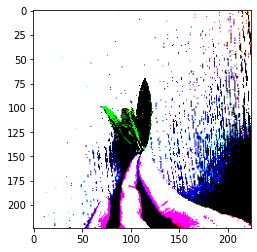

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


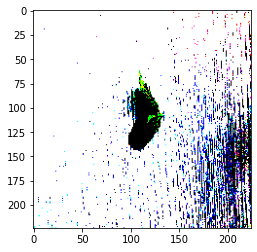

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


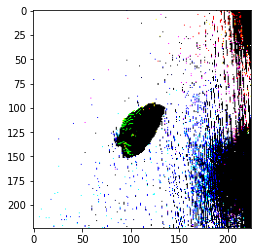

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


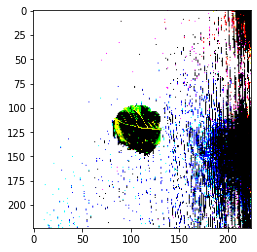

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


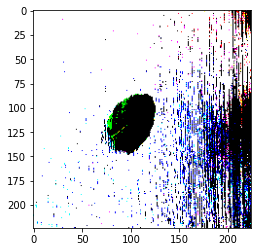

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


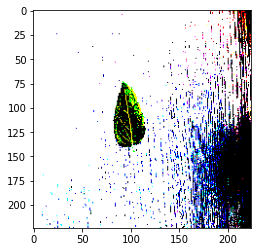

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


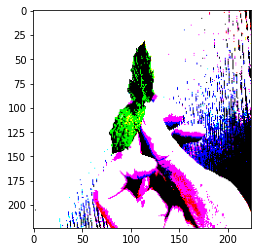

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


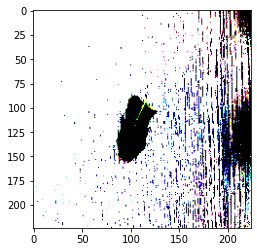

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


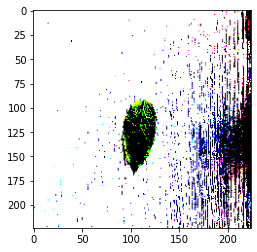

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


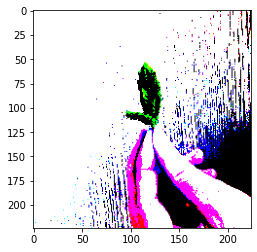

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


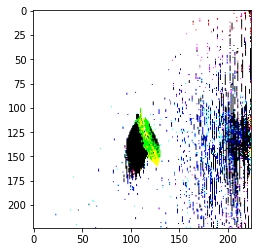

I am a mint leaf


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


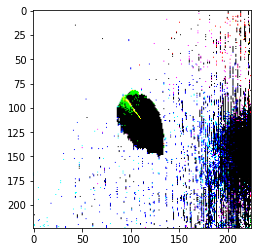

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


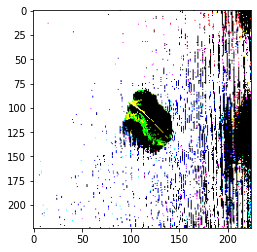

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


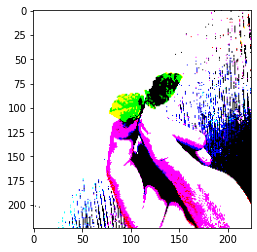

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


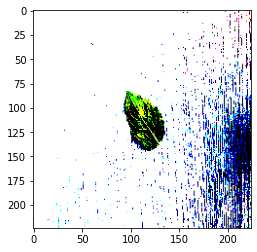

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


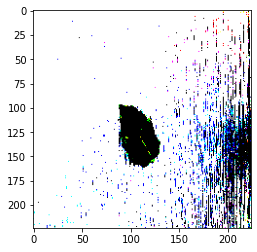

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


I am a mint leaf


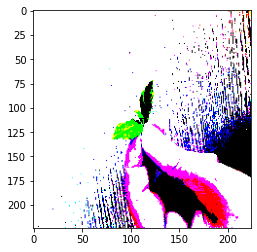

In [15]:
# Check if the zipping worked
for image, label in data:
    if label == 1:
        print('I am a basil leaf')
    if label == 0:
        print('I am a mint leaf')
    plt.imshow(image)
    plt.show()

In [16]:
# Shuffle the data
np.random.shuffle(data)

#### Train-test-split


In [17]:
# Split into train and test
train = data[:160]
test = data[160:]

In [18]:
# Separate X and y
X_train = np.array([image for image in train[:, 0]])
y_train = train[:, 1]

In [19]:
X_test = np.array([image for image in test[:, 0]])
y_test = test[:, 1]

### Expand the model
determine a training and test score

In [20]:
# Make y_train and y_test categorical
y_train = to_categorical(y_train)
y_test = to_categorical(y_test)

In [21]:
# Expand the model
extended_model = Sequential([
    cropped_model,
    Flatten(),
    Dense(10, activation='relu'),
    Dense(2, activation='sigmoid')
])

In [22]:
# Look at the summary
extended_model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Functional)           (None, 7, 7, 512)         14714688  
_________________________________________________________________
flatten (Flatten)            (None, 25088)             0         
_________________________________________________________________
dense (Dense)                (None, 10)                250890    
_________________________________________________________________
dense_1 (Dense)              (None, 2)                 22        
Total params: 14,965,600
Trainable params: 250,912
Non-trainable params: 14,714,688
_________________________________________________________________


In [23]:
# Compile the model again
extended_model.compile(optimizer='adam',
                      loss='binary_crossentropy',
                      metrics=['acc'])

In [24]:
# Check out the performance of the model without any retraining
extended_model.evaluate(X_train, y_train)

5/5 [==============================] - 39s 8s/step - loss: 2.2218 - acc: 0.5175


[2.0992355346679688, 0.518750011920929]

In [25]:
# Retrain the model
history = extended_model.fit(X_train, y_train, epochs=10, validation_split=0.1)

Epoch 1/10
5/5 [==============================] - 35s 7s/step - loss: 2.4296 - acc: 0.6250 - val_loss: 1.1255 - val_acc: 0.6250
Epoch 2/10
5/5 [==============================] - 35s 7s/step - loss: 0.1173 - acc: 0.9583 - val_loss: 0.0948 - val_acc: 1.0000
Epoch 3/10
5/5 [==============================] - 35s 7s/step - loss: 0.0659 - acc: 0.9792 - val_loss: 0.0208 - val_acc: 1.0000
Epoch 4/10
5/5 [==============================] - 36s 7s/step - loss: 0.0100 - acc: 1.0000 - val_loss: 0.0051 - val_acc: 1.0000
Epoch 5/10
5/5 [==============================] - 29s 6s/step - loss: 0.0026 - acc: 1.0000 - val_loss: 0.0021 - val_acc: 1.0000
Epoch 6/10
5/5 [==============================] - 30s 6s/step - loss: 0.0020 - acc: 1.0000 - val_loss: 8.5095e-04 - val_acc: 1.0000
Epoch 7/10
5/5 [==============================] - 29s 6s/step - loss: 5.1121e-04 - acc: 1.0000 - val_loss: 4.2267e-04 - val_acc: 1.0000
Epoch 8/10
5/5 [==============================] - 29s 6s/step - loss: 2.5440e-04 - acc: 1.00

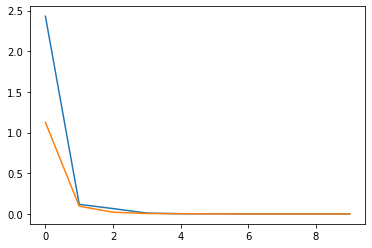

In [26]:
# Plot the curves
plt.plot(history.history['loss'], label='training_loss')
plt.plot(history.history['val_loss'], label='validation_loss')

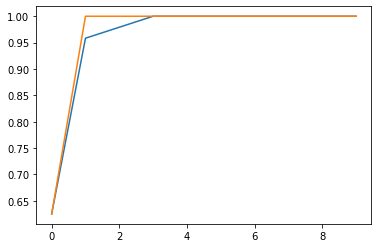

In [27]:
plt.plot(history.history['acc'], label='training_accuracy')
plt.plot(history.history['val_acc'], label='validation_accuracy')

In [28]:
# Check the performance of the model after re-evaluating
extended_model.evaluate(X_test, y_test)

2/2 [==============================] - 9s 3s/step - loss: 0.0169 - acc: 0.9796


[0.01691264659166336, 0.9795918464660645]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


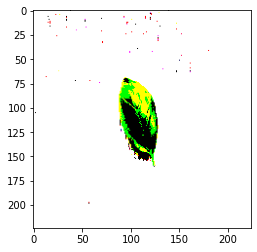

In [29]:
# Check for one image
plt.imshow(X_test[0])

In [30]:
#### Predict on new data

In [32]:
im = plt.imread('./data_pictures_basil_mint/Basil/IMG_4180.jpg')


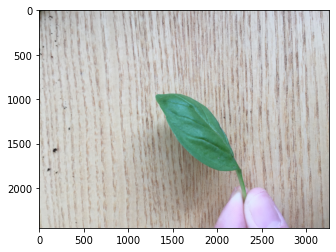

In [33]:
plt.imshow(im)

In [34]:
im.shape

(2448, 3264, 3)

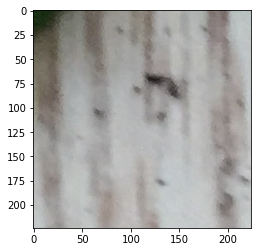

In [35]:
plt.imshow(im[:224,:224,:])

In [36]:
X = cv2.resize(im,(224,224),interpolation=cv2.INTER_CUBIC)

In [37]:
X.shape

(224, 224, 3)

In [38]:
X

array([[[ 27,  47,  22],
        [ 46,  50,  35],
        [105, 107,  96],
        ...,
        [206, 209, 216],
        [203, 208, 214],
        [184, 178, 182]],

       [[ 31,  42,  18],
        [ 77,  74,  62],
        [119, 121, 110],
        ...,
        [208, 211, 216],
        [203, 208, 212],
        [193, 191, 194]],

       [[ 79,  78,  60],
        [ 91,  84,  70],
        [128, 129, 121],
        ...,
        [204, 207, 212],
        [209, 212, 217],
        [200, 203, 208]],

       ...,

       [[190, 181, 164],
        [190, 181, 163],
        [212, 212, 202],
        ...,
        [163, 158, 152],
        [152, 148, 142],
        [157, 152, 146]],

       [[192, 189, 172],
        [197, 186, 170],
        [204, 200, 189],
        ...,
        [161, 158, 151],
        [159, 154, 148],
        [152, 148, 139]],

       [[192, 189, 174],
        [187, 178, 161],
        [208, 201, 191],
        ...,
        [161, 160, 155],
        [156, 151, 147],
        [147, 143, 134]]

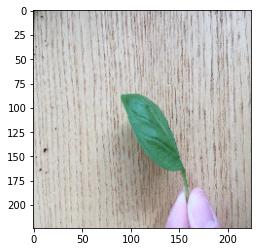

In [39]:
plt.imshow(X)

In [40]:
X = np.expand_dims(X, axis=0)

In [41]:
X.shape 

(1, 224, 224, 3)

In [42]:
results = extended_model.predict(X)
results

array([[3.829408e-08, 1.000000e+00]], dtype=float32)

In [50]:
# start here 
decode_predictions(results, 1)

ValueError: `decode_predictions` expects a batch of predictions (i.e. a 2D array of shape (samples, 1000)). Found array with shape: (1, 2)

In [44]:
results.shape 

(1, 2)

In [45]:
class_idx = tensorflow.argmax(X).numpy()

In [46]:
p = tensorflow.nn.softmax(X)[class_idx]

InvalidArgumentError: Value for attr 'T' of uint8 is not in the list of allowed values: half, bfloat16, float, double
	; NodeDef: {{node Softmax}}; Op<name=Softmax; signature=logits:T -> softmax:T; attr=T:type,allowed=[DT_HALF, DT_BFLOAT16, DT_FLOAT, DT_DOUBLE]> [Op:Softmax]

In [48]:
extended_model.classes

AttributeError: 'Sequential' object has no attribute 'classes'

In [49]:
y_proba = model.predict(X)
y_classes = keras.np_utils.probas_to_classes(y_proba)

NameError: name 'keras' is not defined